In [1]:
import pandas as pd
# reading dataset
df = pd.read_csv("../grid/grid-export.csv")

df.tail()

,Day,PM1(mcg/m³),PM10(mcg/m³),PM2.5(mcg/m³),AQI US,NO(mcg/m³),NO2(mcg/m³),CH2O(mcg/m³),SO2(mcg/m³),Temperature(°C),Humidity(%)
434,2022-08-28,6.20,70.48,16.81,59.52,8.89,27.58,0.0,21.67,24.34,31.41
435,2022-08-29,5.39,66.65,15.50,55.99,28.52,34.23,0.0,20.19,23.77,35.32
436,2022-08-30,5.11,64.76,14.81,54.21,5.69,30.39,0.0,19.31,23.57,36.31
437,2022-08-31,5.58,69.77,15.52,56.70,3.86,27.57,0.0,18.83,24.97,32.14
438,2022-09-01,5.63,71.57,16.26,58.86,4.77,28.98,0.0,20.86,25.68,31.01


In [2]:
df.drop('AQI US', axis=1, inplace=True)
df.drop('NO(mcg/m³)', axis=1, inplace=True)
df.drop('NO2(mcg/m³)', axis=1, inplace=True)
df.drop('CH2O(mcg/m³)', axis=1, inplace=True)
df.drop('SO2(mcg/m³)', axis=1, inplace=True)
df.drop('Temperature(°C)', axis=1, inplace=True)
df.drop('Humidity(%)', axis=1, inplace=True)

In [4]:
df.tail()

,Day,PM1(mcg/m³),PM10(mcg/m³),PM2.5(mcg/m³)
434,2022-08-28,6.20,70.48,16.81
435,2022-08-29,5.39,66.65,15.50
436,2022-08-30,5.11,64.76,14.81
437,2022-08-31,5.58,69.77,15.52
438,2022-09-01,5.63,71.57,16.26


### ARIMA MODEL

In [5]:
pm1 = df.drop('PM10(mcg/m³)', axis=1)
pm1 = pm1.drop('PM2.5(mcg/m³)', axis=1)

In [6]:
pm1.tail()

,Day,PM1(mcg/m³)
434,2022-08-28,6.20
435,2022-08-29,5.39
436,2022-08-30,5.11
437,2022-08-31,5.58
438,2022-09-01,5.63


In [7]:
pm1["Day"] = pd.to_datetime(pm1["Day"])


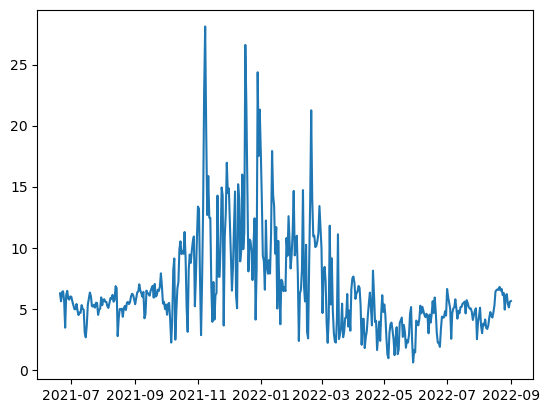

In [8]:
import matplotlib.pyplot as plt
plt.plot(pm1['Day'], pm1['PM1(mcg/m³)'])

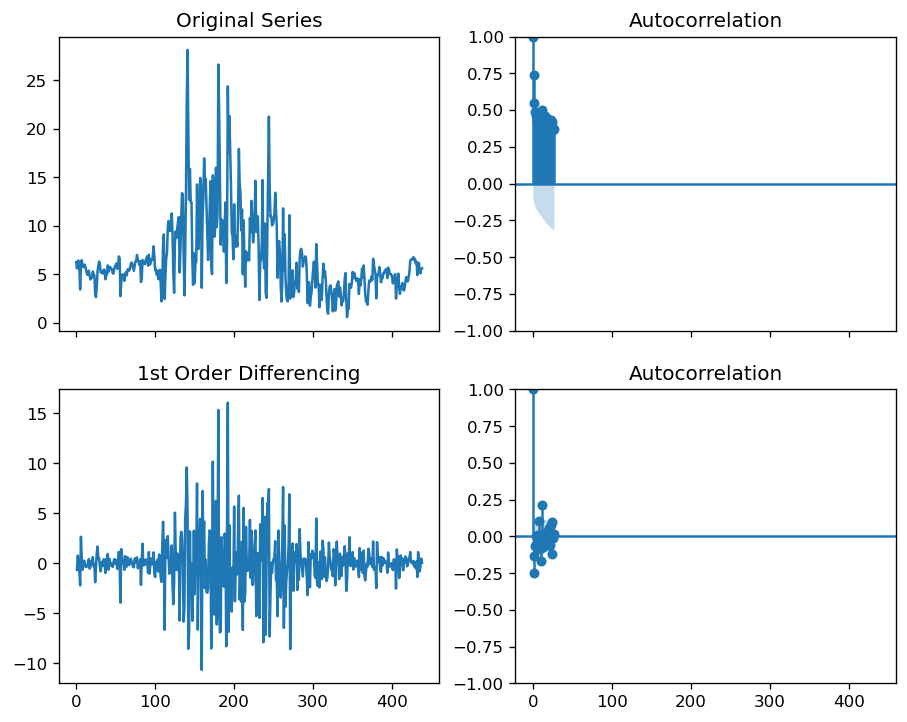

In [9]:
# Importing the modules
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
# fixing the size
plt.rcParams.update({'figure.figsize':(9,7), 'figure.dpi':120})

# Original Series
fig, axes = plt.subplots(2, 2, sharex=True)
axes[0, 0].plot(pm1['PM1(mcg/m³)']); axes[0, 0].set_title('Original Series')
plot_acf(pm1['PM1(mcg/m³)'], ax=axes[0, 1])
# 1st Differencing to make stationary time series data
axes[1, 0].plot(pm1['PM1(mcg/m³)'].diff()); axes[1, 0].set_title('1st Order Differencing')
plot_acf(pm1['PM1(mcg/m³)'].diff().dropna(), ax=axes[1, 1])
plt.show()
plt.show()

In [10]:
# Value of d set to 1

/home/uca/.local/lib/python3.10/site-packages/statsmodels/graphics/tsaplots.py:348: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  warnings.warn(


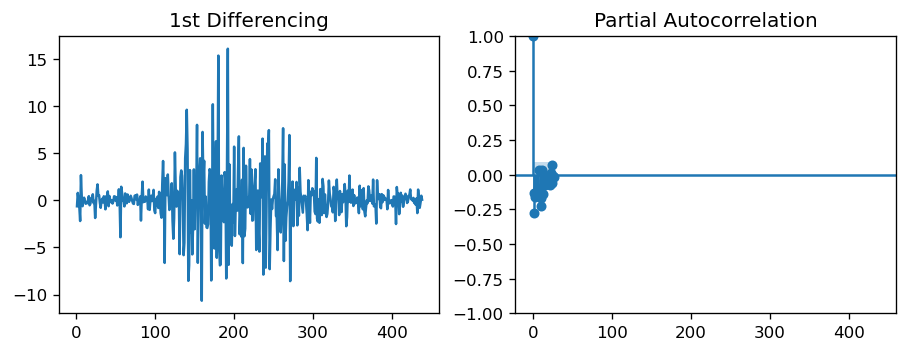

In [11]:
#importing modules
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
# PACF plot of 1st differenced series
plt.rcParams.update({'figure.figsize':(9,3), 'figure.dpi':120})
# fixing the axis
fig, axes = plt.subplots(1, 2, sharex=True)
# plotting on differen axis
axes[0].plot(pm1['PM1(mcg/m³)'].diff()); axes[0].set_title('1st Differencing')
axes[1].set(ylim=(0,5))
# plotting partial autocorrelation function
plot_pacf(pm1['PM1(mcg/m³)'].diff().dropna(), ax=axes[1])
plt.show()

In [12]:
# Value of p is 1

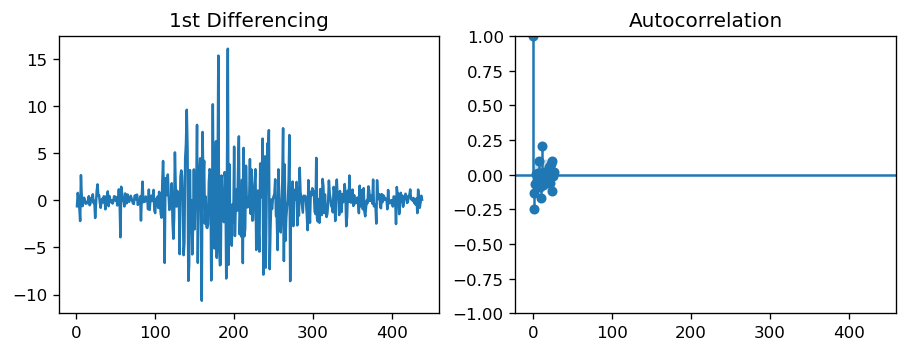

In [13]:
# setting the size
plt.rcParams.update({'figure.figsize':(9,3), 'figure.dpi':120})
#  fixing the subplots
fig, axes = plt.subplots(1, 2, sharex=True)
axes[0].plot(pm1['PM1(mcg/m³)'].diff()); axes[0].set_title('1st Differencing')
axes[1].set(ylim=(0,1.2))
# plotting the autocorrelation function
plot_acf(pm1['PM1(mcg/m³)'].diff().dropna(), ax=axes[1])
plt.show()

In [14]:
# value of q can be 1, 2, or 3

In [15]:
# !pip install statsmodels==0.6.1

In [16]:
data = pm1[:439]['PM1(mcg/m³)'].values

In [17]:
train_size = int(len(data) * 0.66)
train, test = data[0:train_size], data[train_size:len(data)]

In [18]:
history = [x for x in train]
predictions = list()

In [19]:
import statsmodels.api as sm


for t in range(len(test)):
    model = sm.tsa.arima.ARIMA(history, order=(5,1,0))
    model_fit = model.fit()
    pred = model_fit.forecast()
    yhat = pred[0]
    predictions.append(yhat)
    # Append test observation into overall record
    obs = test[t]
    history.append(obs)

In [22]:
# from sklearn.metrics import mean_squared_error
# from math import sqrt
# rmse = sqrt(mean_squared_error(test, predictions))
# print('Test RMSE: %.3f' % rmse)


In [23]:
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.metrics import r2_score

# calculating the r score 
print('R score is :', r2_score(test, predictions))
# printing the mean absolute error
print(mean_absolute_error(test, predictions))
# printing the mean squared error
print(mean_squared_error(test, predictions))

R score is : 0.4198786419760079
0.8163547485890433
1.2055883635166988


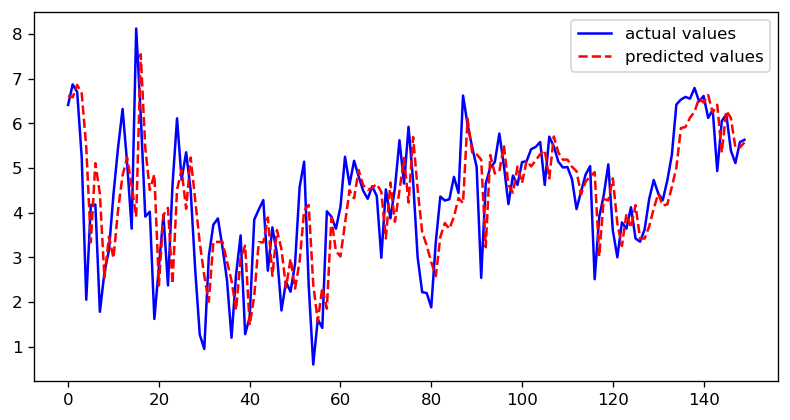

In [24]:
# importing the module
import matplotlib.pyplot as plt

# figure size
plt.figure(figsize=(8, 4))

# acutal values
plt.plot([i for i in range(len(test))] ,test, c='b', label="actual values")

# predicted values
plt.plot([i for i in range(len(test))],predictions, c='r',label="predicted values", linestyle='dashed')
plt.legend()
plt.show()

In [30]:
date = pd.date_range(start='2022-09-01', end='2022-09-07')

pre=model_fit.predict(start=438,end=444,dynamic=True)

In [31]:
pre = pd.Series(pre)
pre.index  = date

<AxesSubplot:>

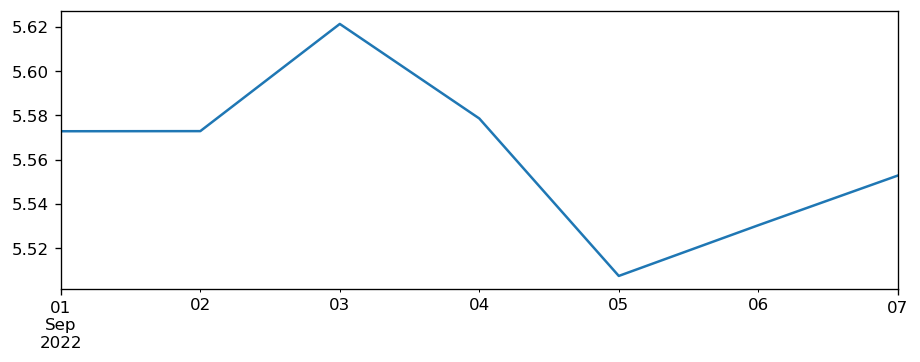

In [32]:
pre.plot()

In [33]:
# # setting the size
# plt.rcParams.update({'figure.figsize':(9,3), 'figure.dpi':120})
# #  fixing the subplots
# fig, axes = plt.subplots(1, 2, sharex=True)
# axes[0].plot(pm1['PM1(mcg/m³)'].diff()); axes[0].set_title('1st Differencing')
# axes[1].set(ylim=(0,1.2))
# # plotting the autocorrelation function
# plot_acf(pm1['PM1(mcg/m³)'].diff().dropna(), ax=axes[1])
# plt.show()

## PM10

In [34]:
pm10 = df.drop('PM1(mcg/m³)', axis=1)
pm10 = pm10.drop('PM2.5(mcg/m³)', axis=1)

In [35]:
pm10["Day"] = pd.to_datetime(pm10["Day"])


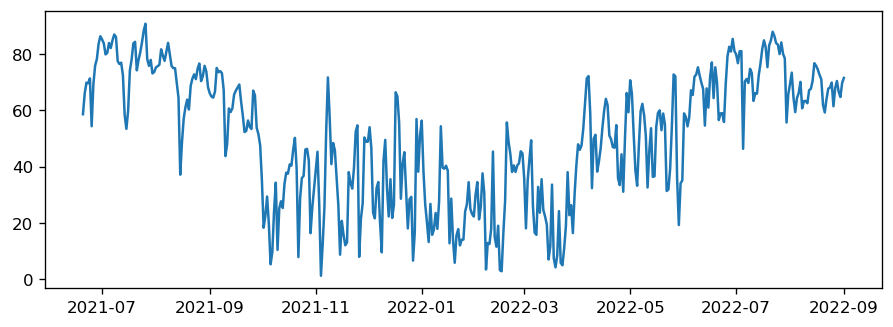

In [36]:
import matplotlib.pyplot as plt
plt.plot(pm10['Day'], pm10['PM10(mcg/m³)'])

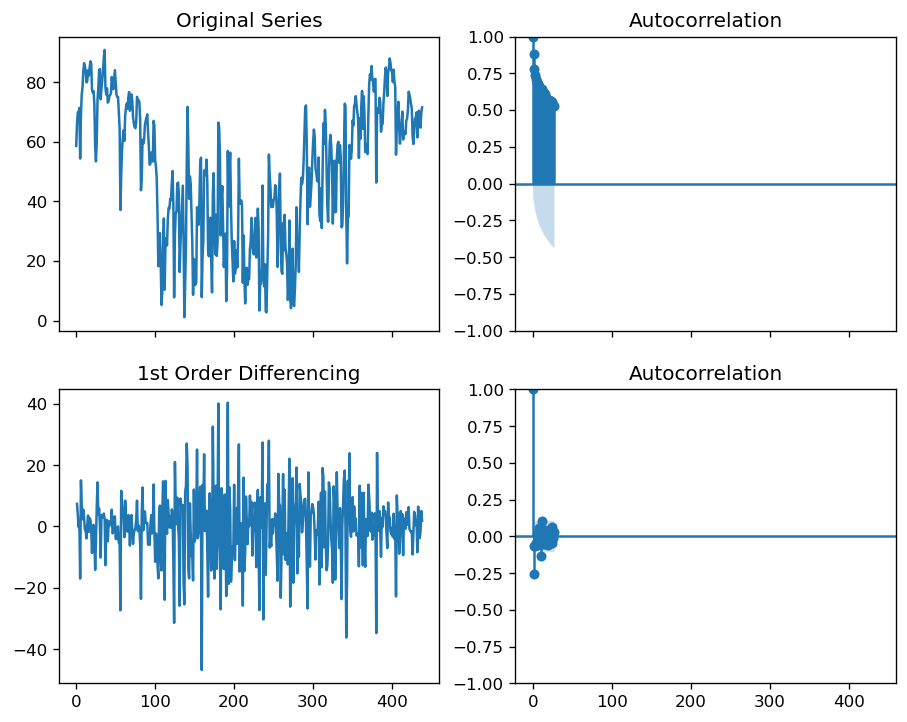

In [37]:
# Importing the modules
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
# fixing the size
plt.rcParams.update({'figure.figsize':(9,7), 'figure.dpi':120})

# Original Series
fig, axes = plt.subplots(2, 2, sharex=True)
axes[0, 0].plot(pm10['PM10(mcg/m³)']); axes[0, 0].set_title('Original Series')
plot_acf(pm10['PM10(mcg/m³)'], ax=axes[0, 1])
# 1st Differencing to make stationary time series data
axes[1, 0].plot(pm10['PM10(mcg/m³)'].diff()); axes[1, 0].set_title('1st Order Differencing')
plot_acf(pm10['PM10(mcg/m³)'].diff().dropna(), ax=axes[1, 1])
plt.show()
plt.show()

/home/uca/.local/lib/python3.10/site-packages/statsmodels/graphics/tsaplots.py:348: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  warnings.warn(


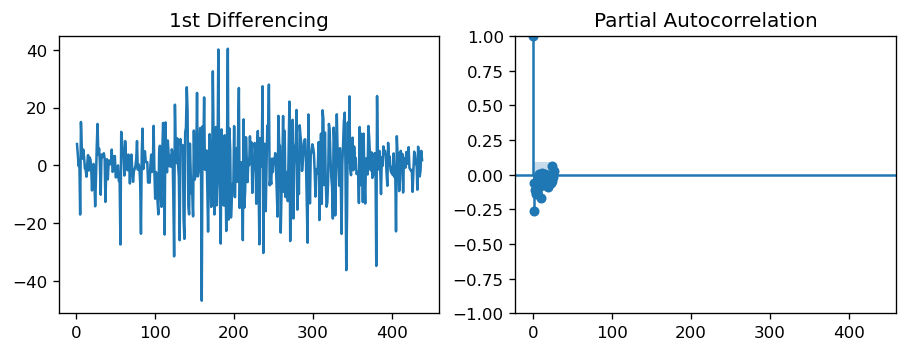

In [38]:
#importing modules
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
# PACF plot of 1st differenced series
plt.rcParams.update({'figure.figsize':(9,3), 'figure.dpi':120})
# fixing the axis
fig, axes = plt.subplots(1, 2, sharex=True)
# plotting on differen axis
axes[0].plot(pm10['PM10(mcg/m³)'].diff()); axes[0].set_title('1st Differencing')
axes[1].set(ylim=(0,5))
# plotting partial autocorrelation function
plot_pacf(pm10['PM10(mcg/m³)'].diff().dropna(), ax=axes[1])
plt.show()

In [39]:
data = pm10[:439]['PM10(mcg/m³)'].values

train_size = int(len(data) * 0.66)
train, test = data[0:train_size], data[train_size:len(data)]

history = [x for x in train]
predictions = list()

import statsmodels.api as sm


for t in range(len(test)):
    model = sm.tsa.arima.ARIMA(history, order=(5,1,0))
    model_fit = model.fit()
    pred = model_fit.forecast()
    yhat = pred[0]
    predictions.append(yhat)
    # Append test observation into overall record
    obs = test[t]
    history.append(obs)

In [41]:
# from sklearn.metrics import mean_squared_error
# from math import sqrt
# rmse = sqrt(mean_squared_error(test, predictions))
# print('Test RMSE: %.3f' % rmse)
# calculating the r score 
print('R score is :', r2_score(test, predictions))
# printing the mean absolute error
print(mean_absolute_error(test, predictions))
# printing the mean squared error
print(mean_squared_error(test, predictions))

R score is : 0.5969175197699546
6.7919634072679305
84.23859217501011


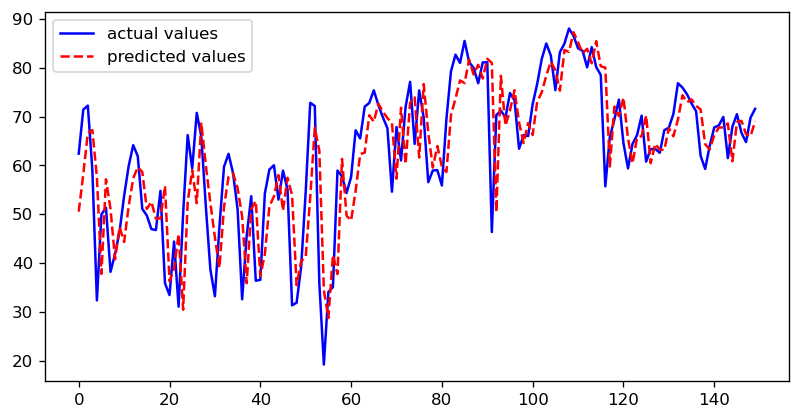

In [42]:
# importing the module
import matplotlib.pyplot as plt

# figure size
plt.figure(figsize=(8, 4))

# acutal values
plt.plot([i for i in range(len(test))] ,test, c='b', label="actual values")

# predicted values
plt.plot([i for i in range(len(test))],predictions, c='r',label="predicted values", linestyle='dashed')
plt.legend()
plt.show()

In [44]:
date = pd.date_range(start='2022-09-01', end='2022-09-07')

pre=model_fit.predict(start=438,end=444,dynamic=True)

pre = pd.Series(pre)
pre.index  = date



<AxesSubplot:>

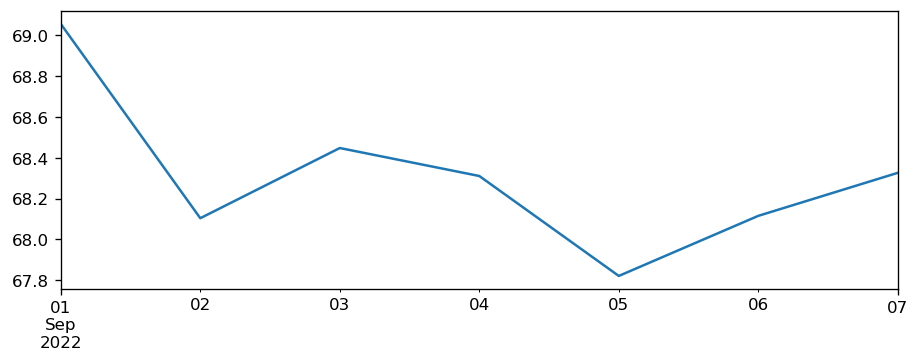

In [45]:
pre.plot()

### PM2.5


In [47]:
pm2 = df.drop('PM10(mcg/m³)', axis=1)
pm2 = pm2.drop('PM1(mcg/m³)', axis=1)

pm2["Day"] = pd.to_datetime(pm2["Day"])


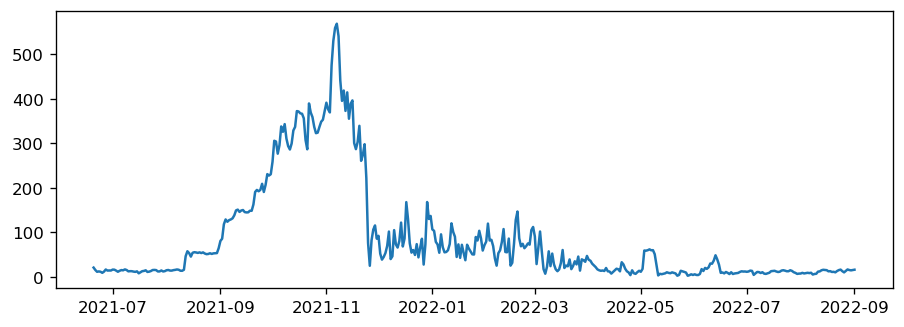

In [48]:
import matplotlib.pyplot as plt
plt.plot(pm2['Day'], pm2['PM2.5(mcg/m³)'])

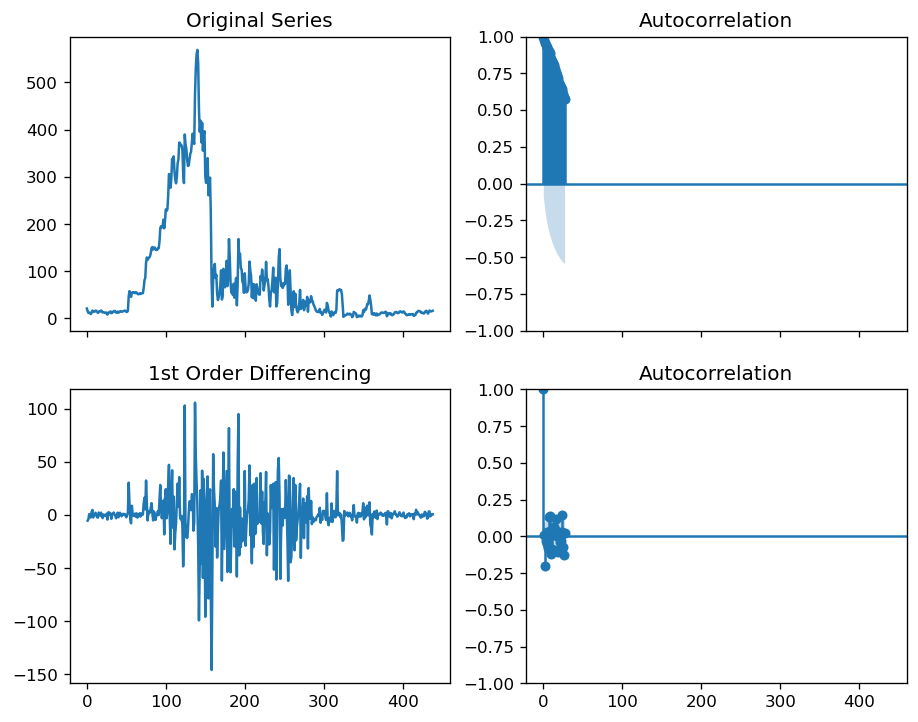

In [50]:
# Importing the modules
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
# fixing the size
plt.rcParams.update({'figure.figsize':(9,7), 'figure.dpi':120})

# Original Series
fig, axes = plt.subplots(2, 2, sharex=True)
axes[0, 0].plot(pm2['PM2.5(mcg/m³)']); axes[0, 0].set_title('Original Series')
plot_acf(pm2['PM2.5(mcg/m³)'], ax=axes[0, 1])
# 1st Differencing to make stationary time series data
axes[1, 0].plot(pm2['PM2.5(mcg/m³)'].diff()); axes[1, 0].set_title('1st Order Differencing')
plot_acf(pm2['PM2.5(mcg/m³)'].diff().dropna(), ax=axes[1, 1])
plt.show()
plt.show()

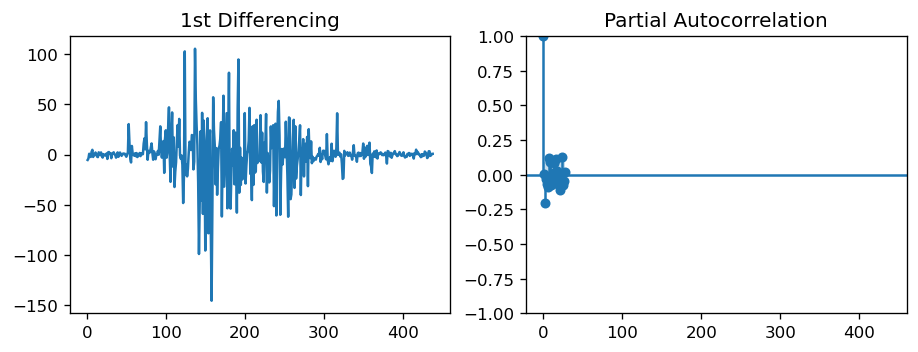

In [51]:
#importing modules
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
# PACF plot of 1st differenced series
plt.rcParams.update({'figure.figsize':(9,3), 'figure.dpi':120})
# fixing the axis
fig, axes = plt.subplots(1, 2, sharex=True)
# plotting on differen axis
axes[0].plot(pm2['PM2.5(mcg/m³)'].diff()); axes[0].set_title('1st Differencing')
axes[1].set(ylim=(0,5))
# plotting partial autocorrelation function
plot_pacf(pm2['PM2.5(mcg/m³)'].diff().dropna(), ax=axes[1])
plt.show()

In [52]:
data = pm2[:439]['PM2.5(mcg/m³)'].values

train_size = int(len(data) * 0.66)
train, test = data[0:train_size], data[train_size:len(data)]

history = [x for x in train]
predictions = list()

import statsmodels.api as sm


for t in range(len(test)):
    model = sm.tsa.arima.ARIMA(history, order=(5,1,0))
    model_fit = model.fit()
    pred = model_fit.forecast()
    yhat = pred[0]
    predictions.append(yhat)
    # Append test observation into overall record
    obs = test[t]
    history.append(obs)

In [53]:
print('R score is :', r2_score(test, predictions))
# printing the mean absolute error
print(mean_absolute_error(test, predictions))
# printing the mean squared error
print(mean_squared_error(test, predictions))

R score is : 0.7185058921995158
3.5666842844701954
39.581776124297875


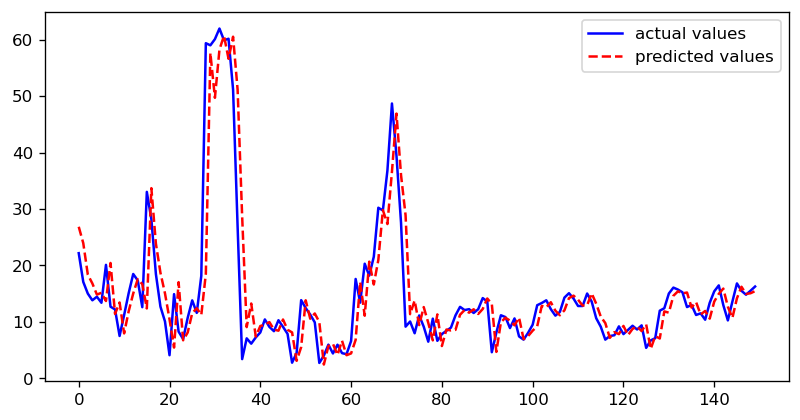

In [54]:

# figure size
plt.figure(figsize=(8, 4))

# acutal values
plt.plot([i for i in range(len(test))] ,test, c='b', label="actual values")

# predicted values
plt.plot([i for i in range(len(test))],predictions, c='r',label="predicted values", linestyle='dashed')
plt.legend()
plt.show()

In [55]:
date = pd.date_range(start='2022-09-01', end='2022-09-07')

pre=model_fit.predict(start=438,end=444,dynamic=True)

pre = pd.Series(pre)
pre.index  = date

<AxesSubplot:>

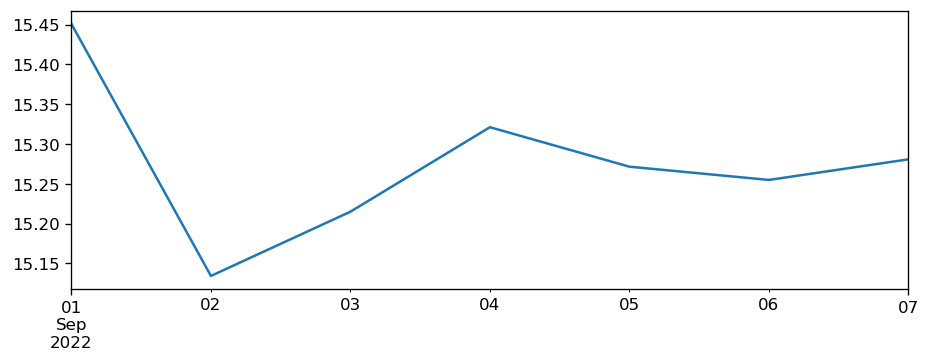

In [56]:
pre.plot()

### AQI

In [59]:
import pandas as pd
# reading dataset
df = pd.read_csv("../grid/grid-export.csv")

df.tail()

,Day,PM1(mcg/m³),PM10(mcg/m³),PM2.5(mcg/m³),AQI US,NO(mcg/m³),NO2(mcg/m³),CH2O(mcg/m³),SO2(mcg/m³),Temperature(°C),Humidity(%)
434,2022-08-28,6.20,70.48,16.81,59.52,8.89,27.58,0.0,21.67,24.34,31.41
435,2022-08-29,5.39,66.65,15.50,55.99,28.52,34.23,0.0,20.19,23.77,35.32
436,2022-08-30,5.11,64.76,14.81,54.21,5.69,30.39,0.0,19.31,23.57,36.31
437,2022-08-31,5.58,69.77,15.52,56.70,3.86,27.57,0.0,18.83,24.97,32.14
438,2022-09-01,5.63,71.57,16.26,58.86,4.77,28.98,0.0,20.86,25.68,31.01


In [60]:
# df.drop('AQI US', axis=1, inplace=True)
df.drop('NO(mcg/m³)', axis=1, inplace=True)
df.drop('NO2(mcg/m³)', axis=1, inplace=True)
df.drop('CH2O(mcg/m³)', axis=1, inplace=True)
df.drop('SO2(mcg/m³)', axis=1, inplace=True)
df.drop('Temperature(°C)', axis=1, inplace=True)
df.drop('Humidity(%)', axis=1, inplace=True)
df.drop('PM1(mcg/m³)', axis=1, inplace=True)
df.drop('PM10(mcg/m³)', axis=1, inplace=True)
df.drop('PM2.5(mcg/m³)', axis=1, inplace=True)

In [62]:
df['day'] = pd.to_datetime(df["Day"])

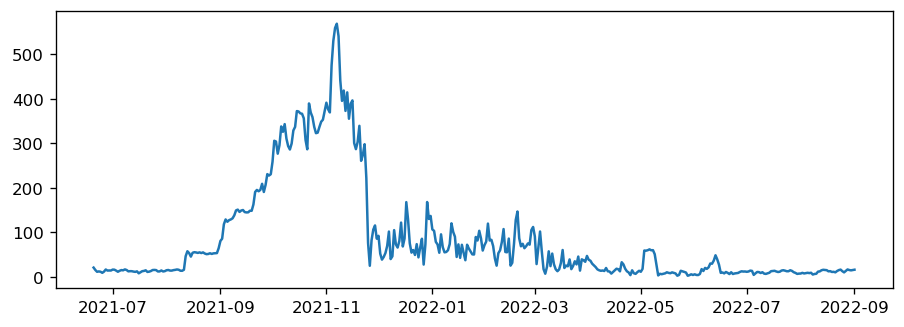

In [63]:
import matplotlib.pyplot as plt
plt.plot(pm2['Day'], pm2['PM2.5(mcg/m³)'])

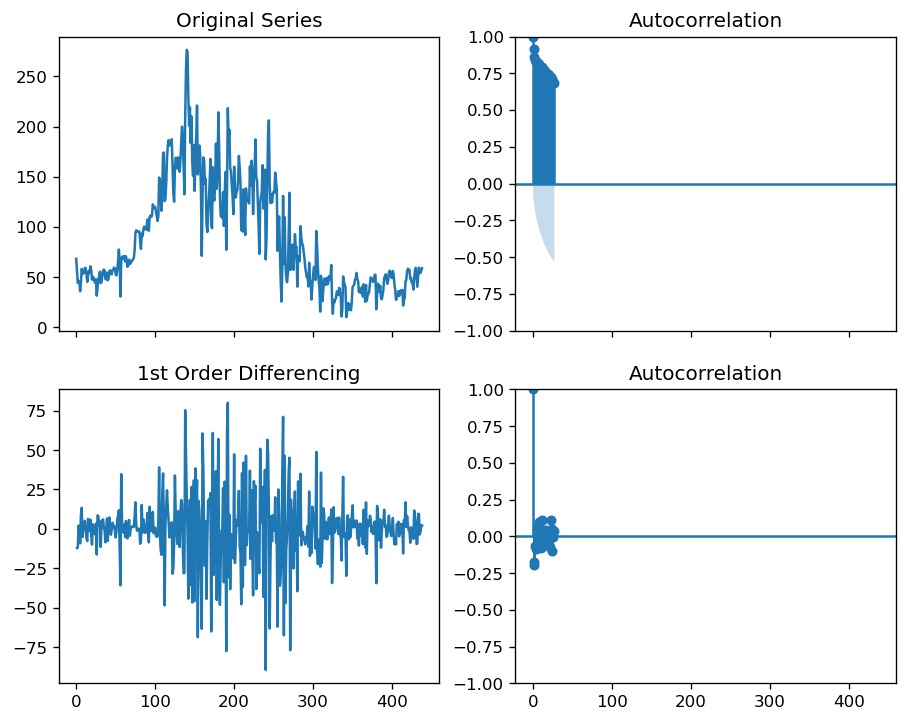

In [64]:
# Importing the modules
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
# fixing the size
plt.rcParams.update({'figure.figsize':(9,7), 'figure.dpi':120})

# Original Series
fig, axes = plt.subplots(2, 2, sharex=True)
axes[0, 0].plot(df['AQI US']); axes[0, 0].set_title('Original Series')
plot_acf(df['AQI US'], ax=axes[0, 1])
# 1st Differencing to make stationary time series data
axes[1, 0].plot(df['AQI US'].diff()); axes[1, 0].set_title('1st Order Differencing')
plot_acf(df['AQI US'].diff().dropna(), ax=axes[1, 1])
plt.show()
plt.show()

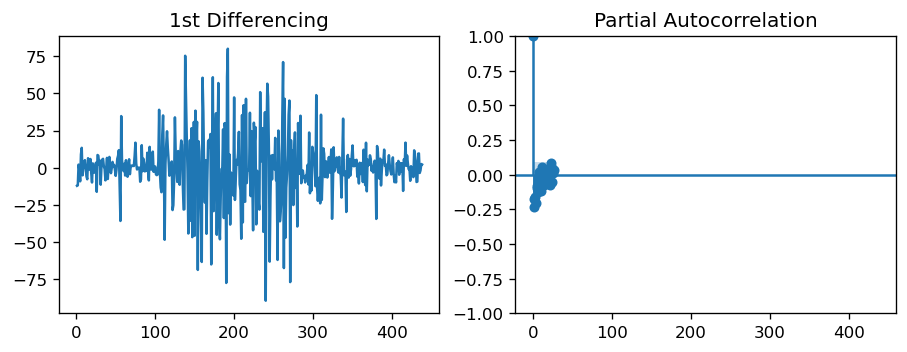

In [65]:
#importing modules
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
# PACF plot of 1st differenced series
plt.rcParams.update({'figure.figsize':(9,3), 'figure.dpi':120})
# fixing the axis
fig, axes = plt.subplots(1, 2, sharex=True)
# plotting on differen axis
axes[0].plot(df['AQI US'].diff()); axes[0].set_title('1st Differencing')
axes[1].set(ylim=(0,5))
# plotting partial autocorrelation function
plot_pacf(df['AQI US'].diff().dropna(), ax=axes[1])
plt.show()

In [66]:
data = df[:439]['AQI US'].values

train_size = int(len(data) * 0.66)
train, test = data[0:train_size], data[train_size:len(data)]

history = [x for x in train]
predictions = list()

import statsmodels.api as sm


for t in range(len(test)):
    model = sm.tsa.arima.ARIMA(history, order=(5,1,0))
    model_fit = model.fit()
    pred = model_fit.forecast()
    yhat = pred[0]
    predictions.append(yhat)
    # Append test observation into overall record
    obs = test[t]
    history.append(obs)

In [67]:
print('R score is :', r2_score(test, predictions))
# printing the mean absolute error
print(mean_absolute_error(test, predictions))
# printing the mean squared error
print(mean_squared_error(test, predictions))

R score is : 0.35635031130883676
7.64229577129694
114.74431945532682


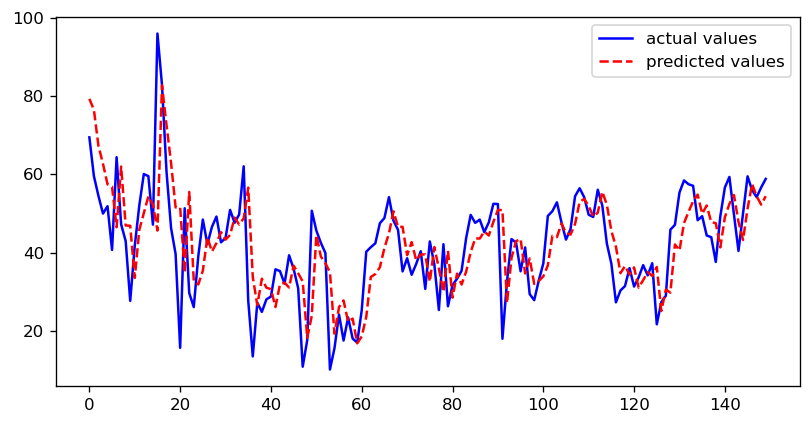

In [68]:
# figure size
plt.figure(figsize=(8, 4))

# acutal values
plt.plot([i for i in range(len(test))] ,test, c='b', label="actual values")

# predicted values
plt.plot([i for i in range(len(test))],predictions, c='r',label="predicted values", linestyle='dashed')
plt.legend()
plt.show()

In [69]:
date = pd.date_range(start='2022-09-01', end='2022-09-07')

pre=model_fit.predict(start=438,end=444,dynamic=True)

pre = pd.Series(pre)
pre.index  = date

<AxesSubplot:>

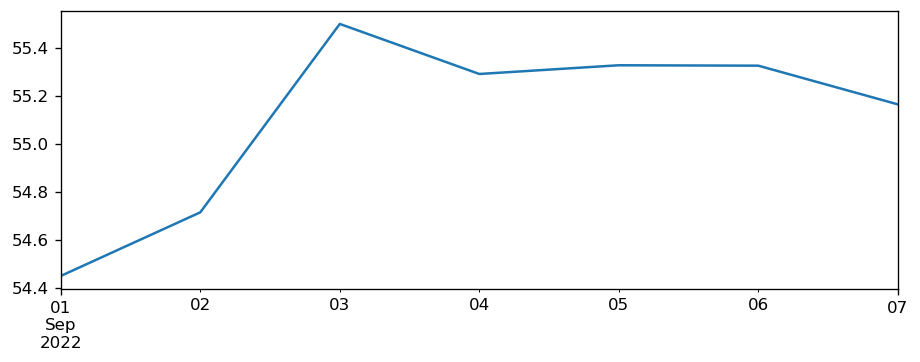

In [70]:
pre.plot()

## PyCaret

In [46]:
from pycaret import *
pm1.set_index('Day')

,PM1(mcg/m³)
Day,
2021-06-20,6.26
2021-06-21,5.61
2021-06-22,6.38
2021-06-23,6.43
2021-06-24,5.66
...,...
2022-08-28,6.20
2022-08-29,5.39
2022-08-30,5.11


In [8]:
# Converting the Data frame into series

In [9]:
# getting only output values
p = pm1['PM1(mcg/m³)']

# converting the date into list
d =list(pm1['Day'])

# indeing with date
p.index = d

print(type(p))
print(p)

<class 'pandas.core.series.Series'>
2021-06-20    6.26
2021-06-21    5.61
2021-06-22    6.38
2021-06-23    6.43
2021-06-24    5.66
              ... 
2022-08-28    6.20
2022-08-29    5.39
2022-08-30    5.11
2022-08-31    5.58
2022-09-01    5.63
Name: PM1(mcg/m³), Length: 439, dtype: float64


In [10]:
print(type(d))

<class 'list'>


<AxesSubplot:>

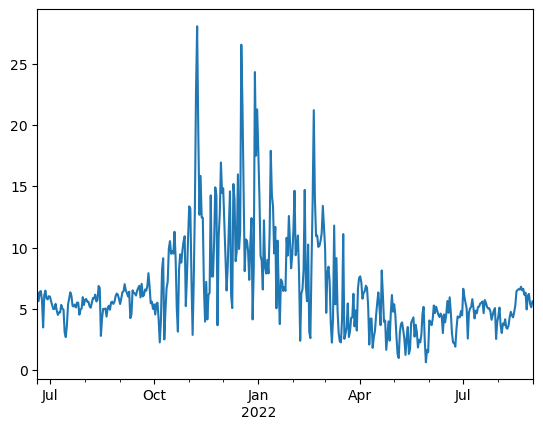

In [11]:
p.plot()

In [12]:
# import pycaret time series and init setup
from pycaret.time_series import *
s = setup(p, fh = 3, session_id = 123)

RuntimeError: module compiled against API version 0x10 but this version of numpy is 0xf . Check the section C-API incompatibility at the Troubleshooting ImportError section at https://numpy.org/devdocs/user/troubleshooting-importerror.html#c-api-incompatibility for indications on how to solve this problem .

,Description,Value
0,session_id,123
1,Target,PM1(mcg/m³)
2,Approach,Univariate
3,Exogenous Variables,Not Present
4,Original data shape,"(439, 1)"
5,Transformed data shape,"(439, 1)"
6,Transformed train set shape,"(436, 1)"
7,Transformed test set shape,"(3, 1)"
8,Rows with missing values,0.0%
9,Fold Generator,ExpandingWindowSplitter


In [13]:
### Anazlye part

In [14]:
# import TSForecastingExperiment and init the class
from pycaret.time_series import TSForecastingExperiment
exp = TSForecastingExperiment()

In [15]:
# init setup on exp
exp.setup(p, fh = 3, session_id = 123)

,Description,Value
0,session_id,123
1,Target,PM1(mcg/m³)
2,Approach,Univariate
3,Exogenous Variables,Not Present
4,Original data shape,"(439, 1)"
5,Transformed data shape,"(439, 1)"
6,Transformed train set shape,"(436, 1)"
7,Transformed test set shape,"(3, 1)"
8,Rows with missing values,0.0%
9,Fold Generator,ExpandingWindowSplitter


In [16]:
# check statistical tests on original data
check_stats()

,Test,Test Name,Data,Property,Setting,Value
0,Summary,Statistics,Transformed,Length,,439.0
1,Summary,Statistics,Transformed,# Missing Values,,0.0
2,Summary,Statistics,Transformed,Mean,,6.697768
3,Summary,Statistics,Transformed,Median,,5.58
4,Summary,Statistics,Transformed,Standard Deviation,,3.943215
5,Summary,Statistics,Transformed,Variance,,15.548942
6,Summary,Statistics,Transformed,Kurtosis,,5.442065
7,Summary,Statistics,Transformed,Skewness,,1.96139
8,Summary,Statistics,Transformed,# Distinct Values,,355.0
9,White Noise,Ljung-Box,Transformed,Test Statictic,"{'alpha': 0.05, 'K': 24}",2279.826768


In [17]:
# compare baseline models
best = compare_models()

,Model,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2,TT (Sec)
theta,Theta Forecaster,0.2220,0.1866,0.5968,0.7491,0.1044,0.0982,-8.3855,0.0400
naive,Naive Forecaster,0.2354,0.1818,0.6322,0.7287,0.1110,0.1102,-3.1869,1.4567
grand_means,Grand Means Forecaster,0.2362,0.1805,0.6346,0.7237,0.1141,0.1031,-2.8283,1.3467
ets,ETS,0.2915,0.2162,0.7834,0.8678,0.1344,0.1297,-16.1958,1.1533
exp_smooth,Exponential Smoothing,0.2916,0.2162,0.7838,0.8679,0.1345,0.1298,-16.1732,0.2000
omp_cds_dt,Orthogonal Matching Pursuit w/ Cond. Deseasonalize & Detrending,0.2935,0.2119,0.7886,0.8502,0.1324,0.1365,-17.2125,0.1233
gbr_cds_dt,Gradient Boosting w/ Cond. Deseasonalize & Detrending,0.2989,0.2388,0.8039,0.9588,0.1396,0.1279,-18.5614,0.2400
en_cds_dt,Elastic Net w/ Cond. Deseasonalize & Detrending,0.3207,0.2307,0.8623,0.9265,0.1395,0.1486,-41.5223,0.2233
br_cds_dt,Bayesian Ridge w/ Cond. Deseasonalize & Detrending,0.3257,0.2420,0.8755,0.9717,0.1425,0.1512,-44.8088,0.1100
auto_arima,Auto ARIMA,0.3270,0.2413,0.8787,0.9684,0.1392,0.1531,-47.1819,22.6500


In [18]:
# compare models using OOP
exp.compare_models()

,Model,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2,TT (Sec)
theta,Theta Forecaster,0.2220,0.1866,0.5968,0.7491,0.1044,0.0982,-8.3855,0.0333
naive,Naive Forecaster,0.2354,0.1818,0.6322,0.7287,0.1110,0.1102,-3.1869,0.0267
grand_means,Grand Means Forecaster,0.2362,0.1805,0.6346,0.7237,0.1141,0.1031,-2.8283,0.0267
ets,ETS,0.2915,0.2162,0.7834,0.8678,0.1344,0.1297,-16.1958,1.2100
exp_smooth,Exponential Smoothing,0.2916,0.2162,0.7838,0.8679,0.1345,0.1298,-16.1732,0.2600
omp_cds_dt,Orthogonal Matching Pursuit w/ Cond. Deseasonalize & Detrending,0.2935,0.2119,0.7886,0.8502,0.1324,0.1365,-17.2125,0.1233
gbr_cds_dt,Gradient Boosting w/ Cond. Deseasonalize & Detrending,0.2989,0.2388,0.8039,0.9588,0.1396,0.1279,-18.5614,0.2100
en_cds_dt,Elastic Net w/ Cond. Deseasonalize & Detrending,0.3207,0.2307,0.8623,0.9265,0.1395,0.1486,-41.5223,0.1967
br_cds_dt,Bayesian Ridge w/ Cond. Deseasonalize & Detrending,0.3257,0.2420,0.8755,0.9717,0.1425,0.1512,-44.8088,0.1100
auto_arima,Auto ARIMA,0.3270,0.2413,0.8787,0.9684,0.1392,0.1531,-47.1819,24.0967


ThetaForecaster(sp=12)

In [18]:
# plot forecast
plot_model(best, plot = 'forecast')

In [19]:
# plot forecast for 36 months in future
plot_model(best, plot = 'forecast', data_kwargs = {'fh' : 10})

In [20]:
# residuals plot
plot_model(best, plot = 'residuals')

In [21]:
#  Predicting

In [22]:
# predict on test set
holdout_pred = predict_model(best)

,Model,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2
0,Theta Forecaster,0.0676,0.0533,0.1806,0.2125,0.0342,0.0336,0.1771


In [23]:
# show predictions df
holdout_pred.head()

,y_pred
2022-08-30,5.4459
2022-08-31,5.4503
2022-09-01,5.5538


In [24]:
# generate forecast for 36 period in future
predict_model(best, fh = 10)

,y_pred
2022-08-30,5.4459
2022-08-31,5.4503
2022-09-01,5.5538
2022-09-02,4.9522
2022-09-03,5.2458
2022-09-04,5.4147
2022-09-05,5.4286
2022-09-06,5.2400
2022-09-07,5.6371
2022-09-08,5.5843


## PM2.5

In [31]:
pm2 = data.drop('PM10(mcg/m³)', axis=1)
pm2 = pm2.drop('PM1(mcg/m³)', axis=1)
pm2["Day"] = pd.to_datetime(pm2["Day"])


In [32]:
pm2.set_index('Day')
# getting only output values
p = pm2['PM2.5(mcg/m³)']

# converting the date into list
d =list(pm2['Day'])

# indeing with date
p.index = d


<AxesSubplot:>

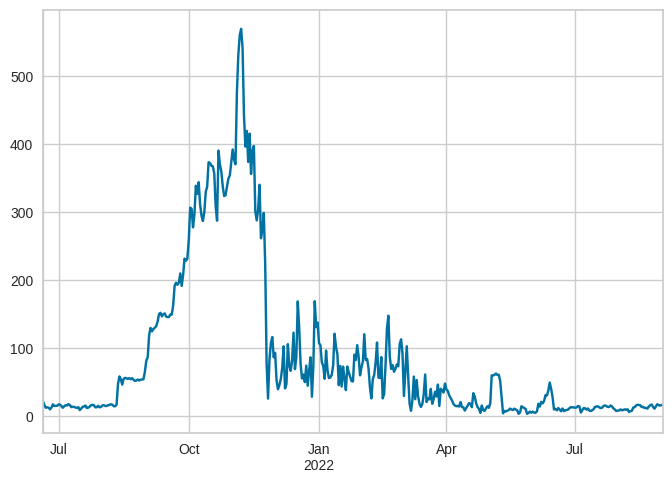

In [33]:
p.plot()

In [34]:
s = setup(p, fh = 3, session_id = 123)

,Description,Value
0,session_id,123
1,Target,PM2.5(mcg/m³)
2,Approach,Univariate
3,Exogenous Variables,Not Present
4,Original data shape,"(439, 1)"
5,Transformed data shape,"(439, 1)"
6,Transformed train set shape,"(436, 1)"
7,Transformed test set shape,"(3, 1)"
8,Rows with missing values,0.0%
9,Fold Generator,ExpandingWindowSplitter


In [35]:
exp = TSForecastingExperiment()

In [36]:
# init setup on exp
exp.setup(p, fh = 3, session_id = 123)

,Description,Value
0,session_id,123
1,Target,PM2.5(mcg/m³)
2,Approach,Univariate
3,Exogenous Variables,Not Present
4,Original data shape,"(439, 1)"
5,Transformed data shape,"(439, 1)"
6,Transformed train set shape,"(436, 1)"
7,Transformed test set shape,"(3, 1)"
8,Rows with missing values,0.0%
9,Fold Generator,ExpandingWindowSplitter


In [37]:
# check statistical tests on original data
check_stats()

,Test,Test Name,Data,Property,Setting,Value
0,Summary,Statistics,Transformed,Length,,439.0
1,Summary,Statistics,Transformed,# Missing Values,,0.0
2,Summary,Statistics,Transformed,Mean,,84.180456
3,Summary,Statistics,Transformed,Median,,36.41
4,Summary,Statistics,Transformed,Standard Deviation,,114.601598
5,Summary,Statistics,Transformed,Variance,,13133.526177
6,Summary,Statistics,Transformed,Kurtosis,,3.242615
7,Summary,Statistics,Transformed,Skewness,,1.979418
8,Summary,Statistics,Transformed,# Distinct Values,,425.0
9,White Noise,Ljung-Box,Transformed,Test Statictic,"{'alpha': 0.05, 'K': 24}",7196.898591


In [38]:
# compare baseline models
best = compare_models()

,Model,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2,TT (Sec)
gbr_cds_dt,Gradient Boosting w/ Cond. Deseasonalize & Detrending,0.0304,0.0220,2.2909,2.7190,0.1698,0.1685,-1.6045,0.3967
br_cds_dt,Bayesian Ridge w/ Cond. Deseasonalize & Detrending,0.0327,0.0224,2.4589,2.7616,0.1877,0.1803,-1.5473,0.1933
croston,Croston,0.0331,0.0227,2.4876,2.7970,0.1724,0.1861,-1.8210,0.0233
ridge_cds_dt,Ridge w/ Cond. Deseasonalize & Detrending,0.0334,0.0229,2.5140,2.8213,0.1920,0.1841,-1.6363,0.2767
lr_cds_dt,Linear w/ Cond. Deseasonalize & Detrending,0.0334,0.0229,2.5140,2.8213,0.1920,0.1841,-1.6363,0.2867
en_cds_dt,Elastic Net w/ Cond. Deseasonalize & Detrending,0.0335,0.0229,2.5198,2.8259,0.1924,0.1846,-1.6587,0.3000
lasso_cds_dt,Lasso w/ Cond. Deseasonalize & Detrending,0.0336,0.0230,2.5265,2.8323,0.1929,0.1851,-1.6833,0.2100
llar_cds_dt,Lasso Least Angular Regressor w/ Cond. Deseasonalize & Detrending,0.0336,0.0230,2.5263,2.8321,0.1929,0.1851,-1.6816,0.1733
snaive,Seasonal Naive Forecaster,0.0354,0.0238,2.6678,2.9339,0.1974,0.1991,-1.3575,0.9967
lar_cds_dt,Least Angular Regressor w/ Cond. Deseasonalize & Detrending,0.0355,0.0250,2.6683,3.0829,0.2052,0.1947,-1.9410,0.1867


In [39]:
# plot forecast
plot_model(best, plot = 'forecast')

In [40]:
# plot forecast for 36 months in future
plot_model(best, plot = 'forecast', data_kwargs = {'fh' : 10})

## PM10


In [38]:
pm10 = data.drop('PM1(mcg/m³)', axis=1)
pm10 = pm10.drop('PM2.5(mcg/m³)', axis=1)
pm10["Day"] = pd.to_datetime(pm10["Day"])

pm10.set_index('Day')
# getting only output values
p = pm10['PM10(mcg/m³)']

# converting the date into list
d =list(pm10['Day'])

# indeing with date
p.index = d

<AxesSubplot:>

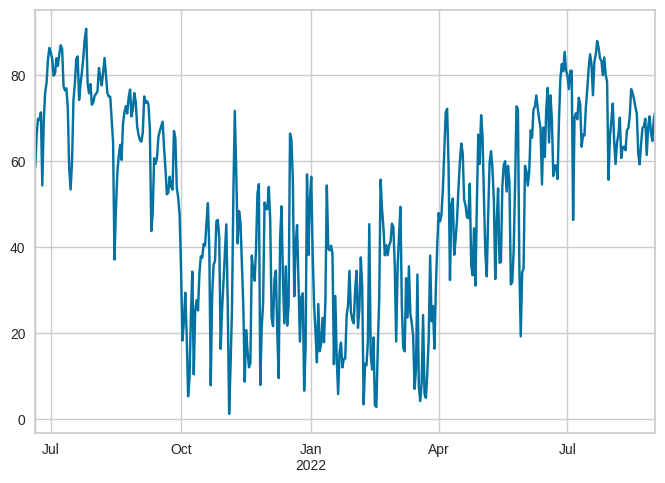

In [39]:
p.plot()

In [40]:
s = setup(p, fh = 3, session_id = 123)

,Description,Value
0,session_id,123
1,Target,PM10(mcg/m³)
2,Approach,Univariate
3,Exogenous Variables,Not Present
4,Original data shape,"(439, 1)"
5,Transformed data shape,"(439, 1)"
6,Transformed train set shape,"(436, 1)"
7,Transformed test set shape,"(3, 1)"
8,Rows with missing values,0.0%
9,Fold Generator,ExpandingWindowSplitter


In [41]:
# init setup on exp
exp.setup(p, fh = 3, session_id = 123)

,Description,Value
0,session_id,123
1,Target,PM10(mcg/m³)
2,Approach,Univariate
3,Exogenous Variables,Not Present
4,Original data shape,"(439, 1)"
5,Transformed data shape,"(439, 1)"
6,Transformed train set shape,"(436, 1)"
7,Transformed test set shape,"(3, 1)"
8,Rows with missing values,0.0%
9,Fold Generator,ExpandingWindowSplitter


In [42]:
# check statistical tests on original data
check_stats()

,Test,Test Name,Data,Property,Setting,Value
0,Summary,Statistics,Transformed,Length,,439.0
1,Summary,Statistics,Transformed,# Missing Values,,0.0
2,Summary,Statistics,Transformed,Mean,,50.503895
3,Summary,Statistics,Transformed,Median,,53.75
4,Summary,Statistics,Transformed,Standard Deviation,,22.813846
5,Summary,Statistics,Transformed,Variance,,520.471556
6,Summary,Statistics,Transformed,Kurtosis,,-1.042222
7,Summary,Statistics,Transformed,Skewness,,-0.289701
8,Summary,Statistics,Transformed,# Distinct Values,,426.0
9,White Noise,Ljung-Box,Transformed,Test Statictic,"{'alpha': 0.05, 'K': 24}",4508.52926


In [ ]:
# compare baseline models
best = compare_models()

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,15:09:01
Status,. . . . . . . . . . . . . . . . . .,Fitting 3 Folds
Estimator,. . . . . . . . . . . . . . . . . .,Auto ARIMA


,Model,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2,TT (Sec)
naive,Naive Forecaster,0.2205,0.1986,4.4456,4.9248,0.0669,0.0686,-6.3361,0.0300
arima,ARIMA,0.4049,0.3661,8.1626,9.0747,0.1238,0.1256,-22.4675,0.7600
snaive,Seasonal Naive Forecaster,0.5083,0.4293,10.2667,10.6610,0.1601,0.1502,-11.6194,0.0300
grand_means,Grand Means Forecaster,0.7949,0.6586,16.0343,16.3352,0.2400,0.2740,-55.0013,0.0267
polytrend,Polynomial Trend Forecaster,0.8103,0.6708,16.3460,16.6384,0.2448,0.2801,-55.6803,0.0267


Processing:   0%|          | 0/125 [00:00<?, ?it/s]

### AQI

In [71]:
import pandas as pd
# reading dataset
data = pd.read_csv("../grid/grid-export.csv")

data.tail()

,Day,PM1(mcg/m³),PM10(mcg/m³),PM2.5(mcg/m³),AQI US,NO(mcg/m³),NO2(mcg/m³),CH2O(mcg/m³),SO2(mcg/m³),Temperature(°C),Humidity(%)
434,2022-08-28,6.20,70.48,16.81,59.52,8.89,27.58,0.0,21.67,24.34,31.41
435,2022-08-29,5.39,66.65,15.50,55.99,28.52,34.23,0.0,20.19,23.77,35.32
436,2022-08-30,5.11,64.76,14.81,54.21,5.69,30.39,0.0,19.31,23.57,36.31
437,2022-08-31,5.58,69.77,15.52,56.70,3.86,27.57,0.0,18.83,24.97,32.14
438,2022-09-01,5.63,71.57,16.26,58.86,4.77,28.98,0.0,20.86,25.68,31.01


In [72]:
data.drop('NO(mcg/m³)', axis=1, inplace=True)
data.drop('NO2(mcg/m³)', axis=1, inplace=True)
data.drop('CH2O(mcg/m³)', axis=1, inplace=True)
data.drop('SO2(mcg/m³)', axis=1, inplace=True)
data.drop('Temperature(°C)', axis=1, inplace=True)
data.drop('Humidity(%)', axis=1, inplace=True)
data.drop('PM1(mcg/m³)', axis=1, inplace=True)
data.drop('PM10(mcg/m³)', axis=1, inplace=True)
data.drop('PM2.5(mcg/m³)', axis=1, inplace=True)

In [73]:
data.head()

,Day,AQI US
0,2021-06-20,68.29
1,2021-06-21,56.14
2,2021-06-22,44.30
3,2021-06-23,46.40
4,2021-06-24,45.06


In [74]:
data["Day"] = pd.to_datetime(data["Day"])


In [75]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 439 entries, 0 to 438
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   Day     439 non-null    datetime64[ns]
 1   AQI US  439 non-null    float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 7.0 KB


In [76]:
data.set_index('Day')
# getting only output values
p = data['AQI US']

# converting the date into list
d =list(data['Day'])

# indeing with date
p.index = d

In [77]:
type(p)

pandas.core.series.Series

<AxesSubplot:>

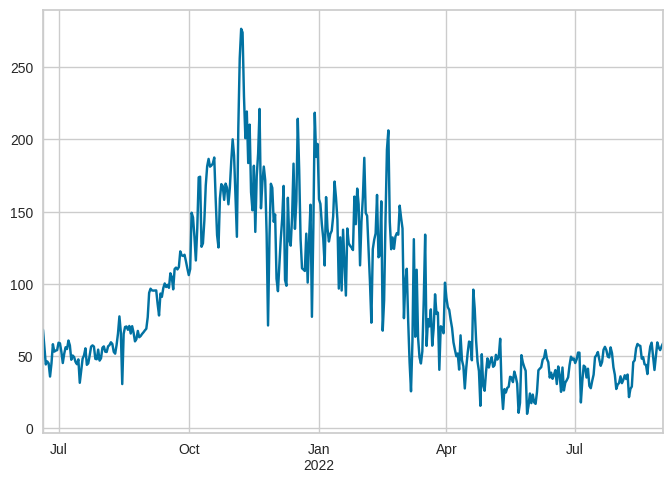

In [78]:
p.plot()

In [79]:
from pycaret.time_series import *

s = setup(p, fh = 3, session_id = 123)

,Description,Value
0,session_id,123
1,Target,AQI US
2,Approach,Univariate
3,Exogenous Variables,Not Present
4,Original data shape,"(439, 1)"
5,Transformed data shape,"(439, 1)"
6,Transformed train set shape,"(436, 1)"
7,Transformed test set shape,"(3, 1)"
8,Rows with missing values,0.0%
9,Fold Generator,ExpandingWindowSplitter


31170
30841


In [80]:
# import TSForecastingExperiment and init the class
from pycaret.time_series import TSForecastingExperiment
exp = TSForecastingExperiment()

In [81]:
# init setup on exp
exp.setup(p, fh = 3, session_id = 123)

,Description,Value
0,session_id,123
1,Target,AQI US
2,Approach,Univariate
3,Exogenous Variables,Not Present
4,Original data shape,"(439, 1)"
5,Transformed data shape,"(439, 1)"
6,Transformed train set shape,"(436, 1)"
7,Transformed test set shape,"(3, 1)"
8,Rows with missing values,0.0%
9,Fold Generator,ExpandingWindowSplitter


In [82]:
# compare baseline models
best = compare_models()

,Model,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2,TT (Sec)
polytrend,Polynomial Trend Forecaster,0.2103,0.1936,6.8827,8.5154,0.1570,0.1368,-0.6298,0.0167
auto_arima,Auto ARIMA,0.2333,0.1932,7.6158,8.4813,0.1511,0.1556,-2.3324,55.8100
croston,Croston,0.2422,0.1994,7.9137,8.7607,0.1521,0.1607,-1.6110,0.0167
ets,ETS,0.2686,0.2165,8.7572,9.5028,0.1715,0.1824,-4.4328,0.2767
br_cds_dt,Bayesian Ridge w/ Cond. Deseasonalize & Detrending,0.2955,0.2312,9.6365,10.1467,0.1913,0.2055,-5.3963,0.1400
huber_cds_dt,Huber w/ Cond. Deseasonalize & Detrending,0.3012,0.2339,9.8232,10.2623,0.1944,0.2099,-5.6539,0.1400
lar_cds_dt,Least Angular Regressor w/ Cond. Deseasonalize & Detrending,0.3043,0.2398,9.9256,10.5248,0.1996,0.2122,-5.5543,0.1333
lasso_cds_dt,Lasso w/ Cond. Deseasonalize & Detrending,0.3049,0.2416,9.9431,10.6034,0.1989,0.2130,-5.8374,0.1267
llar_cds_dt,Lasso Least Angular Regressor w/ Cond. Deseasonalize & Detrending,0.3049,0.2416,9.9437,10.6035,0.1990,0.2130,-5.8393,0.1400
en_cds_dt,Elastic Net w/ Cond. Deseasonalize & Detrending,0.3066,0.2428,9.9992,10.6547,0.2001,0.2144,-5.9294,0.2333


In [86]:
# creating light gradient boosting machine model
LGBM = create_model('auto_arima')

,cutoff,MASE,RMSSE,MAE,RMSE,MAPE,SMAPE,R2
0,2022-08-20,0.1982,0.1672,6.5120,7.3701,0.1428,0.1392,0.1154
1,2022-08-23,0.1632,0.1501,5.3339,6.5953,0.1142,0.1086,0.2694
2,2022-08-26,0.3385,0.2622,11.0015,11.4783,0.1963,0.2190,-7.3820
Mean,NaT,0.2333,0.1932,7.6158,8.4813,0.1511,0.1556,-2.3324
SD,NaT,0.0758,0.0493,2.4419,2.1427,0.0340,0.0465,3.5712


In [88]:
# Plotting the residual plot
# model analysis


NameError: name 'evaluate_model' is not defined

In [83]:
# plot forecast
plot_model(best, plot = 'forecast')

In [84]:
# plot forecast for 36 months in future
plot_model(best, plot = 'forecast', data_kwargs = {'fh' : 10})

In [85]:
# residuals plot
plot_model(best, plot = 'residuals')